In [1]:
import sys
sys.path.append('../../../graphvelo')

import numpy as np
import pandas as pd
import scanpy as sc
import dynamo as dyn

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

/opt/anaconda3/envs/graphvelo/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
from gam import fit_gene_trend

In [3]:
adata = sc.read('gv_result_k50.h5ad')
adata = adata[:, np.where(adata.layers['velocity_gv'].max(0)!=0)[0]]
adata

View of AnnData object with n_obs × n_vars = 4602 × 930
    obs: 'cluster', 'batch', 'n_counts', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time', 'macrostates_fwd', 'term_states_fwd', 'term_states_fwd_probs'
    var: 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'T_fwd_params', 'WNN', 'cluster_colors', 'coarse_fwd', 'eigendecomposition_fwd', 'macrostates_fwd_colors', 'neighbors', 'pca', 'recover_dynamics', 'schur_matrix_fwd', 'term_states_fwd_colors', 'umap', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'T_fwd_umap', 'X_lsi', 'X_lsi_norm', 'X_pca', 'X_pca_norm', 'X_umap', 'gv_lsi', 'gv_pca', 'gv_umap', 'macrostates_fwd_memberships', 'schur_vectors_fwd', 'term

In [4]:
adata.obsm['velocity_umap'] = adata.obsm['gv_umap'].copy()
dyn.vf.VectorField(adata, basis='umap', M=2000, velocity_based_sampling=False, pot_curl_div=True)

|-----> VectorField reconstruction begins...
|-----> Retrieve X and V based on basis: UMAP. 
        Vector field will be learned in the UMAP space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----> [SparseVFC] completed [34.7953s]
|-----> Running ddhodge to estimate vector field based pseudotime in umap basis...
|-----> graphizing vectorfield...
|-----------? nbrs_idx argument is ignored and recomputed because nbrs_idx is not None and return_nbrs=True
|-----------> calculating neighbor indices...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----> [ddhodge completed] completed [101.3194s]
|-----> Computing curl...


Calculating 2-D curl: 100%|██████████| 4602/4602 [00:00<00:00, 16293.10it/s]

|-----> Computing divergence...



Calculating divergence: 100%|██████████| 5/5 [00:00<00:00, 22.82it/s]

|-----> [VectorField] completed [136.9232s]


|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----------> plotting with basis key=X_umap


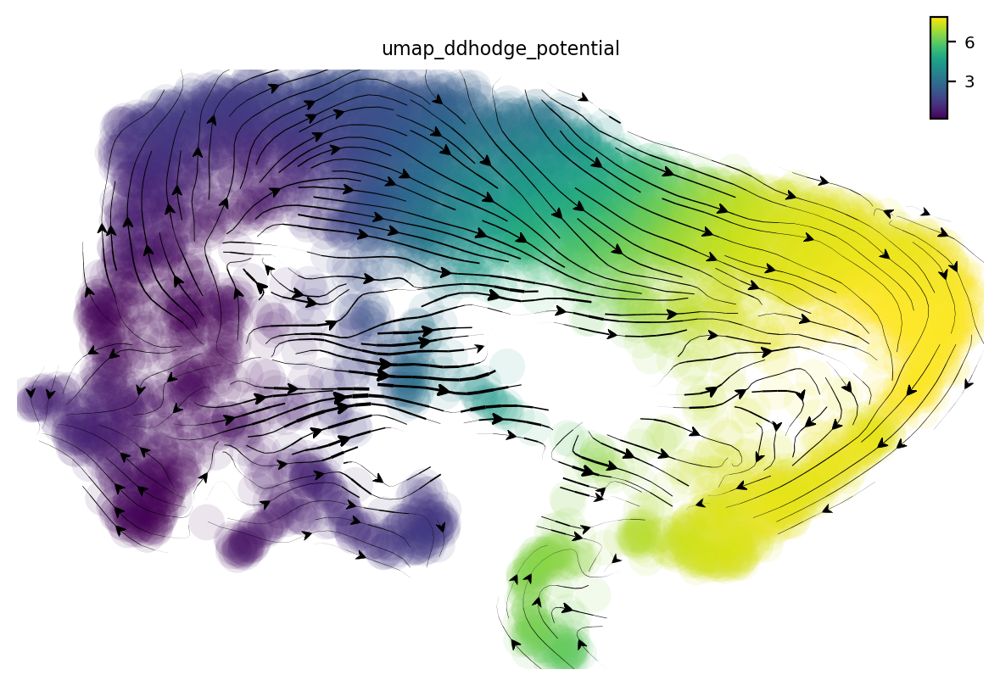

In [5]:
dyn.pl.streamline_plot(adata, color=['umap_ddhodge_potential'])

In [6]:
adata.layers['velocity_gv'] /= adata.layers['velocity_gv'].max(0, keepdims=True)
adata.layers['velocity_c'] /= adata.layers['velocity_c'].A.max(0, keepdims=True)

In [7]:
gdata1 = fit_gene_trend(adata, tkey='umap_ddhodge_potential', layer='velocity_gv', genes=adata.var_names)
gdata2 = fit_gene_trend(adata, tkey='umap_ddhodge_potential', layer='velocity_c', genes=adata.var_names)

Fitting trends using GAM: 100%|██████████| 930/930 [00:07<00:00, 130.41it/s]


In [8]:
gdata2.obs_names = [i+'-chrom' for i in gdata2.obs_names]

In [9]:
gdata = sc.concat([gdata1, gdata2])
gdata

AnnData object with n_obs × n_vars = 1860 × 200

In [10]:
gs = [i for i in adata.var_names if i[-5:]!='chrom']

## DTW

In [11]:
from dtaidistance import dtw

In [12]:
dtw_dist = np.zeros(gdata.n_obs//2)
for i in range(gdata.n_obs//2):
    j = i + gdata.n_obs//2
    d= dtw.distance(gdata[i].X.flatten(), gdata[j].X.flatten())
    dtw_dist[i] = d

In [13]:
def find_elbow_point(sequence):
    sequence = np.array(sequence)
    n_points = len(sequence)
    x = np.arange(n_points)
    
    first_point = np.array([x[0], sequence[0]])
    last_point = np.array([x[-1], sequence[-1]])
    line_vec = last_point - first_point
    line_vec_norm = line_vec / np.linalg.norm(line_vec)

    distances = np.zeros(n_points)
    for i in range(n_points):
        point = np.array([x[i], sequence[i]])
        vec_from_first = point - first_point
        proj_onto_line = np.dot(vec_from_first, line_vec_norm) * line_vec_norm
        vec_to_line = vec_from_first - proj_onto_line
        distances[i] = np.linalg.norm(vec_to_line)
    
    elbow_point_index = np.argmax(distances)
    
    return elbow_point_index

In [14]:
with open('../../../data/CCD_genes.txt', 'r') as file:
    # Read each line in the file and strip newlines or extra spaces
    ccdg = [line.strip() for line in file.readlines()]
sorted_ind = np.argsort(dtw_dist)
ind = find_elbow_point(dtw_dist[sorted_ind])
decouple_genes = gdata.obs_names[sorted_ind[ind:]].tolist()
common_genes = [i for i in gdata.obs_names if i in ccdg]
len(common_genes)

32

In [15]:
common_ind = [gdata.obs_names[sorted_ind].to_list().index(gene) for gene in common_genes]
common_ind_ = [gdata.obs_names[sorted_ind].to_list().index(gene) for gene in ['CENPE', 'KIF11', 'CENPF']] # Decouple genes happened in both mouse hair and human brain datasets

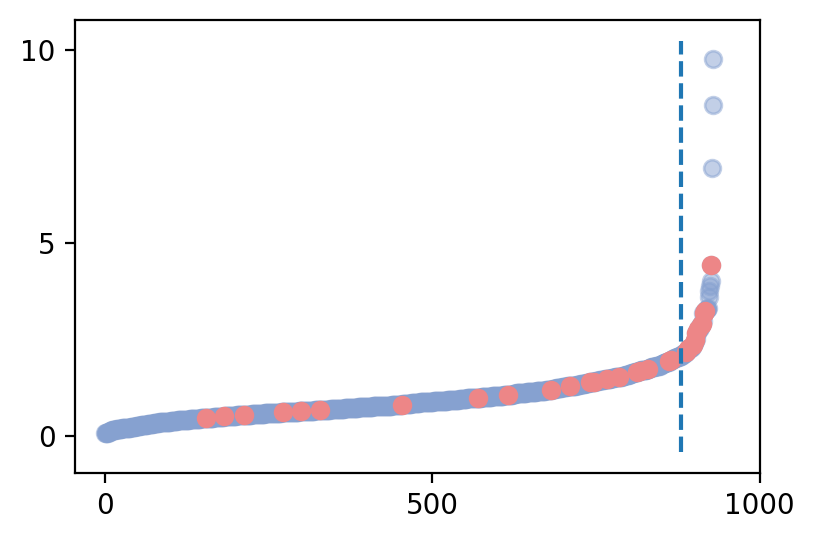

In [16]:
x_val = np.arange(len(dtw_dist))
y_val = dtw_dist[sorted_ind]
fig, ax = plt.subplots(1,1, figsize=(4,2.8))
plt.scatter(x_val, y_val, alpha=0.5, c='#86a1d0')
plt.vlines(np.arange(len(dtw_dist))[ind], plt.ylim()[0], plt.ylim()[1], linestyles='dashed')
plt.scatter(x_val[common_ind], y_val[common_ind], c='#ed8687', alpha=1)
# for idx in common_ind:
#     plt.annotate(gdata.obs_names[sorted_ind][idx], 
#                  (x_val[idx], y_val[idx]), 
#                  xycoords='data',
#                  xytext=(-30,10), 
#                  textcoords="offset points", 
#                  ha='center', 
#                  fontsize=12,
#                  arrowprops=dict(arrowstyle="->"))
plt.tight_layout()
plt.xticks([0,500,1000])
plt.yticks([0,5,10])
# plt.savefig("figures_sup/decouple_rank_genes.pdf", dpi=300, transparent=True)
plt.show()

In [17]:
import gseapy as gp

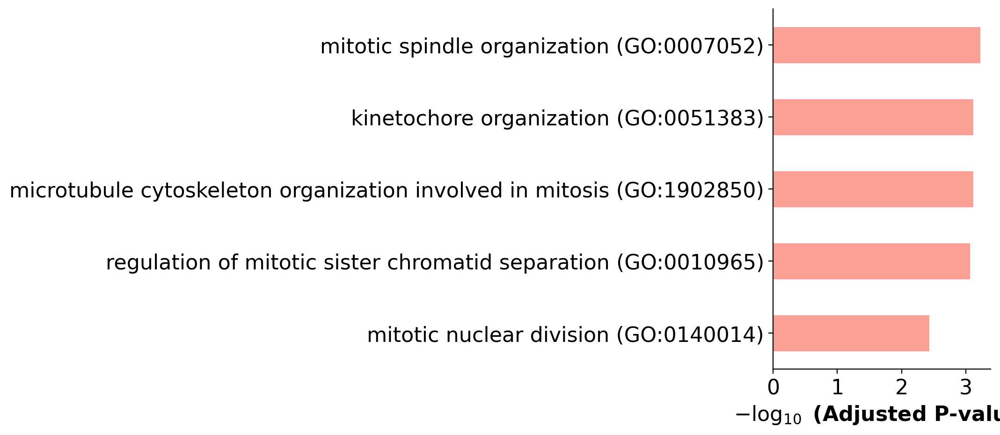

In [18]:
enr = gp.enrichr(decouple_genes, gene_sets='GO_Biological_Process_2018', organism='mouse')
gp.barplot(enr.res2d, figsize=(3,5), top_term=5)
# plt.savefig("figures_sup/decouple_gene_gsea.pdf", transparent=True, dpi=300)
plt.show()

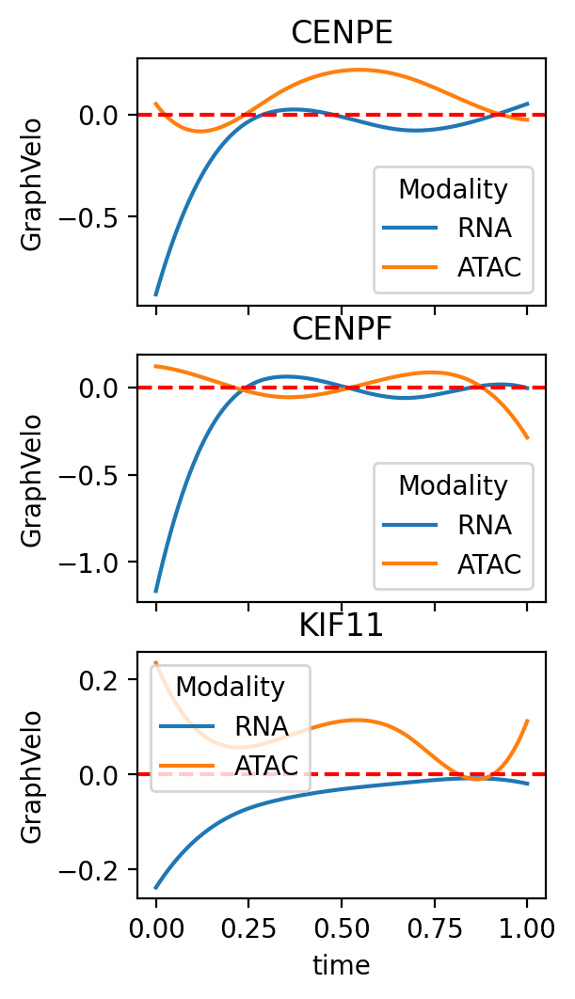

In [19]:
t = np.linspace(0, 1, gdata.n_vars)
fig, axs = plt.subplots(3, 1, figsize=(2.8, 5.8), sharex=True)
axs = axs.flatten()
for i, data in enumerate(['CENPE', 'CENPF', 'KIF11']):
    df = pd.DataFrame(
        {'time': t.tolist()+t.tolist(),
         'GraphVelo': gdata[data].X.flatten().tolist()+gdata[data+'-chrom'].X.flatten().tolist(),
         'Modality': ['RNA']*len(t)+['ATAC']*len(t)
         }
    )
    axs[i] = sns.lineplot(data=df, x='time', y='GraphVelo', hue='Modality', ax=axs[i])
    axs[i].axhline(y=0, color='red', linestyle='--')
    axs[i].set_title(data)
# plt.savefig("figures_sup/decouple_velo_trend.pdf", transparent=True, dpi=300)
plt.show()

|-----------> plotting with basis key=X_umap


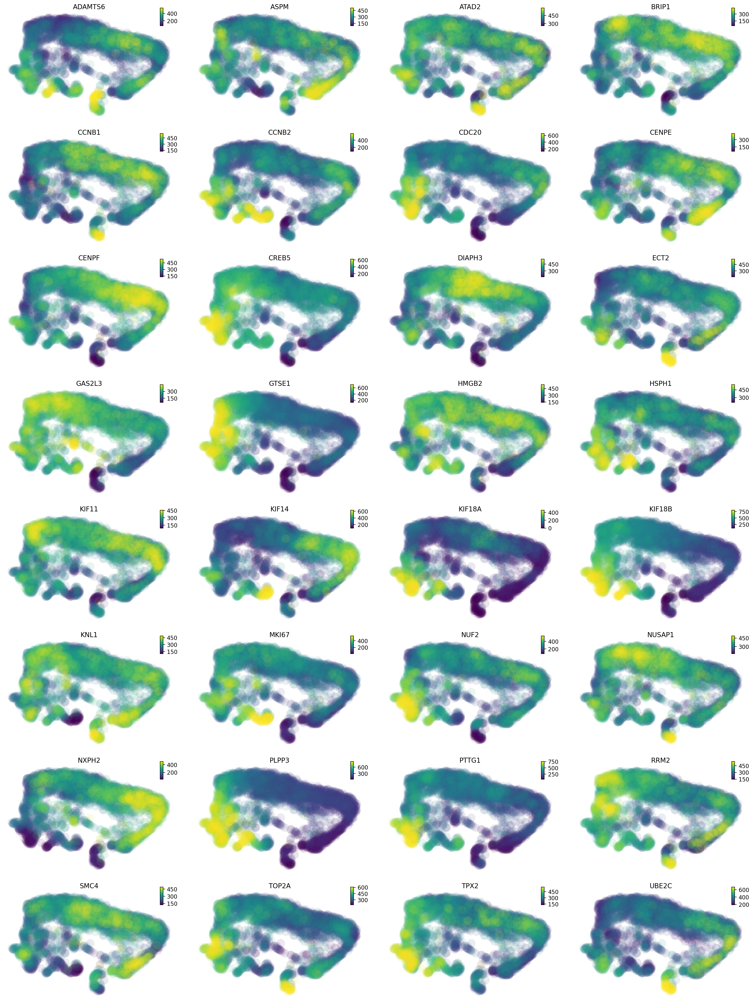

|-----------> plotting with basis key=X_umap


<Figure size 640x480 with 0 Axes>

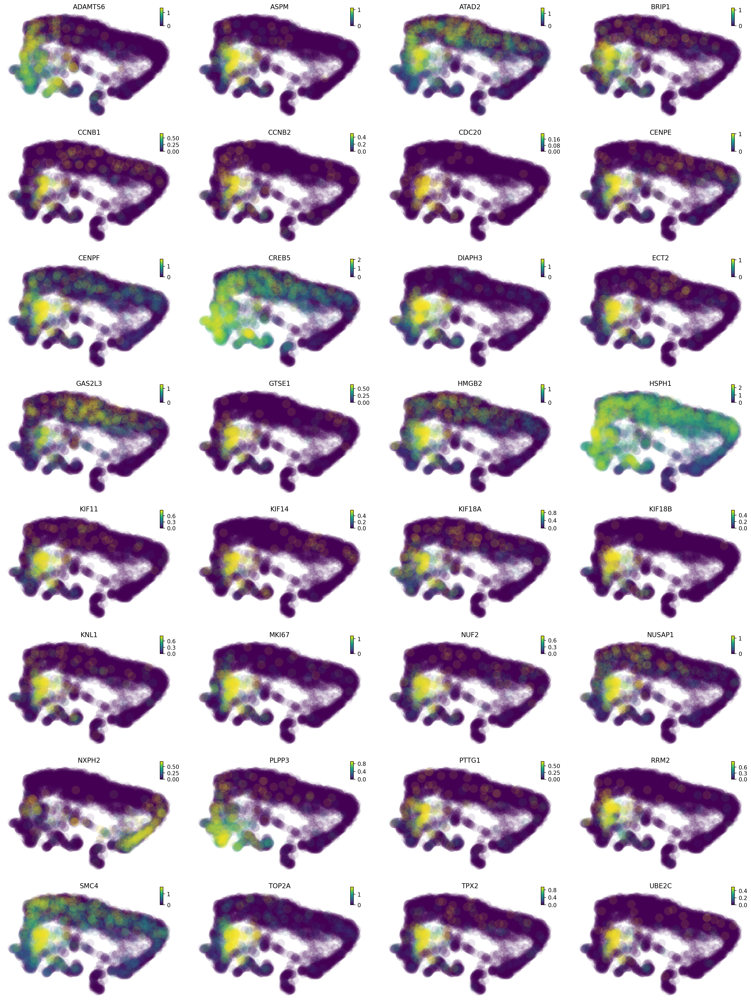

In [20]:
ax = dyn.pl.scatters(adata, color=common_genes, basis='umap', layer='Mc', use_smoothed=False, ncols=4, save_show_or_return='return')
# plt.savefig('figures_sup/decouple_gene_Mc.pdf', transparent=True, dpi=300)
plt.show()
plt.clf()
ax = dyn.pl.scatters(adata, color=common_genes, basis='umap', ncols=4, save_show_or_return='return')
# plt.savefig('figures_sup/decouple_gex.pdf', transparent=True, dpi=300)
plt.show()